Here I choose patches / features from 50 images, and find random patches that are contained in each centile. Each row corresponds to 10 images taken from each centile

In [1]:
import os
import sys
sys.path = ['/nfs/gns/homes/willj/anaconda3/envs/GTEx/lib/python3.5/site-packages'] + sys.path
GTEx_directory = '/hps/nobackup/research/stegle/users/willj/GTEx'
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import scipy
import h5py

def get_patches_in_percentile_range(percentile_range,patches,feature_vector):

    """Return the patches with in a given percentile range"""
    
    percentile_top = percentile_range[1]
    percentile_bottom = percentile_range[0]
    
    top_limit = np.percentile(feature_vector,percentile_top)
    bottom_limit = np.percentile(feature_vector,percentile_bottom)
    bool_idx = np.bitwise_and(feature_vector >= bottom_limit, feature_vector <= top_limit)
    idx = list(np.squeeze(np.argwhere(bool_idx)))
    patches_in_percentile = [all_patches[i] for i in idx]
    features_in_percentile = feature_vector[np.bitwise_and(feature_vector >= bottom_limit, feature_vector <= top_limit)]
    return patches_in_percentile, features_in_percentile

tissue = 'Lung'
patch_size = 256
feature = 895

tissue_filepath = os.path.join(GTEx_directory,'data','raw',tissue)
tissue_images = os.listdir(tissue_filepath)
all_tissue_IDs = [x.split('.')[0] for x in tissue_images]

with h5py.File(GTEx_directory + '/data/retrained_inceptionet_features.hdf5','r') as f:
    filt_tissue_IDs = list(f['lung']['features']['512'].keys())

all_patches = []
all_features = []
for ID in np.random.choice(filt_tissue_IDs,20):
    print (ID)
    
    with h5py.File(GTEx_directory + '/data/better_covering_patches/{}_{}.hdf5'.format(ID,patch_size),'r') as f:
        patches = list(f['patches'].value)
        all_patches.extend(patches)

    with h5py.File(GTEx_directory + '/data/retrained_inceptionet_features.hdf5','r') as f:
        features = list(f['lung']['features'][str(patch_size)][ID].value)
        all_features.extend(features)

all_features = np.array(all_features)
# all_patches = np.array(all_patches)

GTEX-13VXU-2726
GTEX-12WSN-0626
GTEX-13N11-0326
GTEX-ZC5H-0926
GTEX-1399U-0826
GTEX-13O3Q-0526
GTEX-RVPV-1726
GTEX-T5JC-0826
GTEX-WY7C-0426
GTEX-P44H-1126
GTEX-WRHU-0226
GTEX-P4QT-0526
GTEX-Q2AI-0526
GTEX-P4QS-0526
GTEX-11GSP-0726
GTEX-PVOW-1026
GTEX-ZAB5-0626
GTEX-OOBK-0526
GTEX-XOT4-1426
GTEX-SNOS-0426


In [2]:
print (len(all_features))

91473


[37855 44074 31619 22718 23261   984 10050 39900  5594   296]
[37174 46185 16634 32880 48419 25705  7531 30974    54 20924]
[  952 14912 46315 30518 38923 15055 16745 22996 28123 26286]
[47600  2390   246 14602 36693 25758 40684  7432 34941 18219]
[32598 34672 44381 48257 47394 30348 25645 28450  1727 22999]
[ 5817 16765 43453 25391  1554 30547 11269   731    92 24049]
[2151 8552 7799    5  567 2094  930 2307 8523 2304]
[5156 6868 5287 6206  263 6559 9112 8827 3090  959]
[4673 6844 6410 7631 2333 2746 8490 6909 7793 5003]
[6916 2581 4633  212 6818 4547  113 2759 3550 8895]


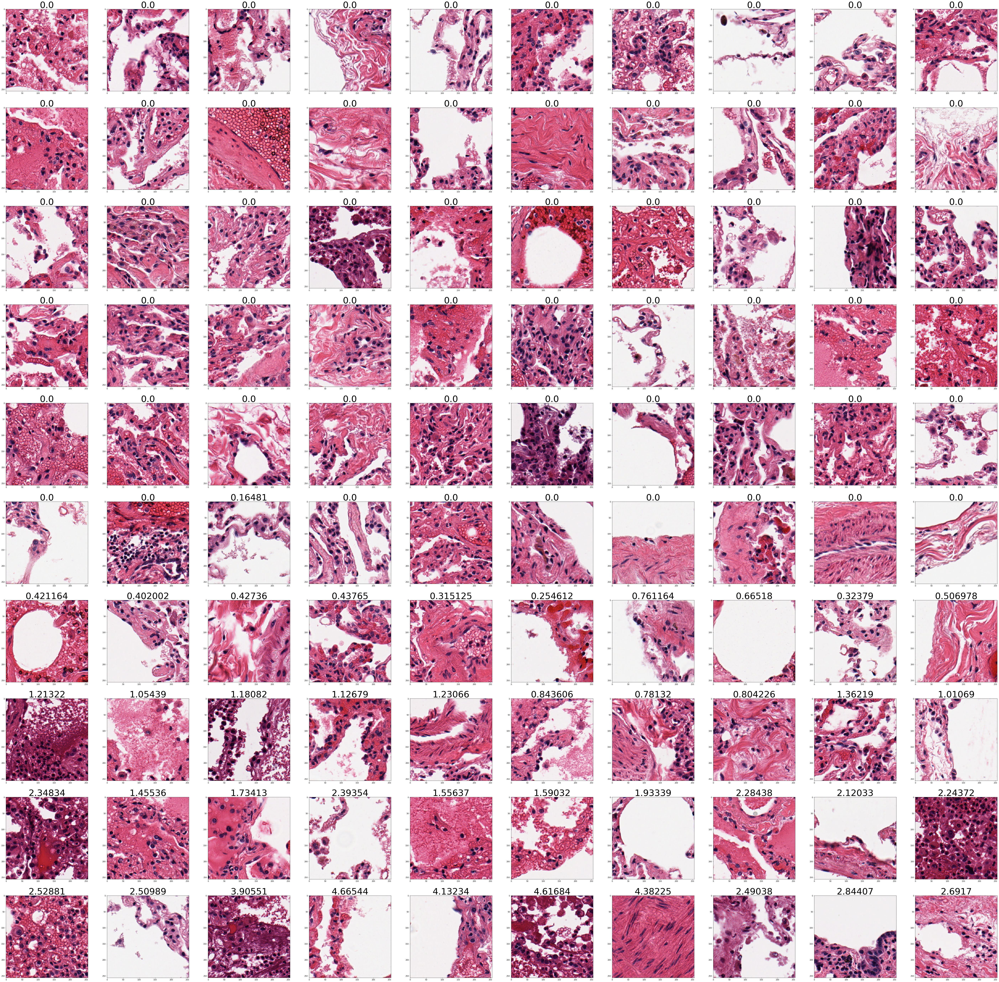

In [3]:
feature_vector = all_features[:,feature]
f, a = plt.subplots(10,10, figsize=(100,100))
for i in range(0,10):
    percentile_range = [10*i,10*(i+1)]
    patches_in_percentile, features_in_percentile = get_patches_in_percentile_range(percentile_range,all_patches,feature_vector)
    random_idx_in_percentile = np.random.choice(range(len(patches_in_percentile)),10)
    print (random_idx_in_percentile)
    random_images_in_percentile = [patches_in_percentile[k] for k in random_idx_in_percentile]
    random_features_in_percentile = features_in_percentile[random_idx_in_percentile]
    for j in range(10):
        a[i][j].imshow(random_images_in_percentile[j])
        a[i][j].set_title(random_features_in_percentile[j], size=50)